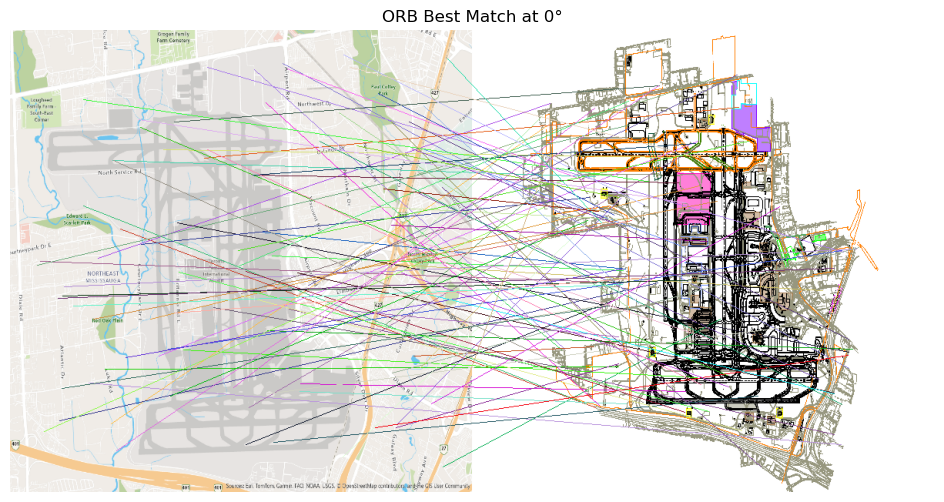

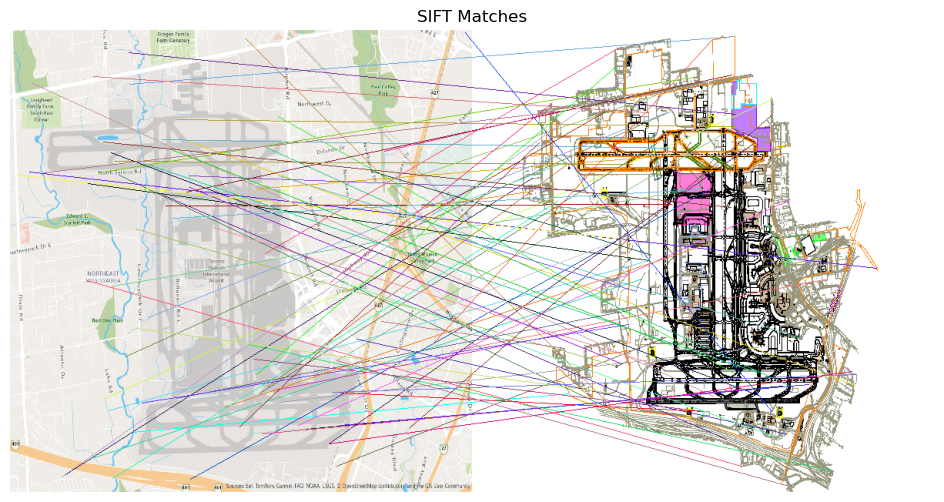

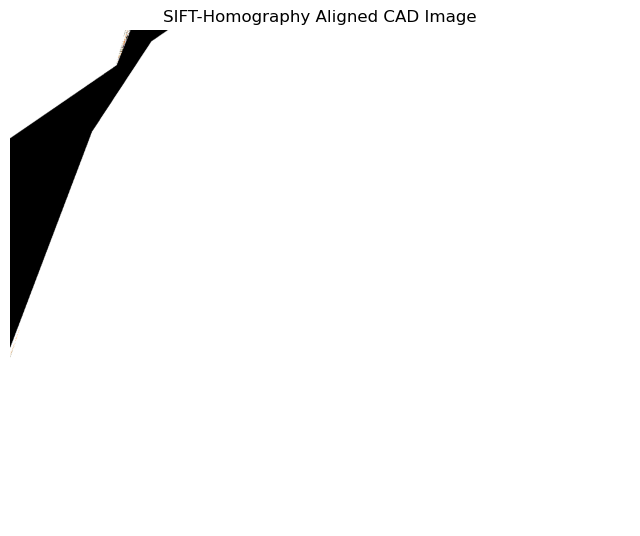

In [144]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


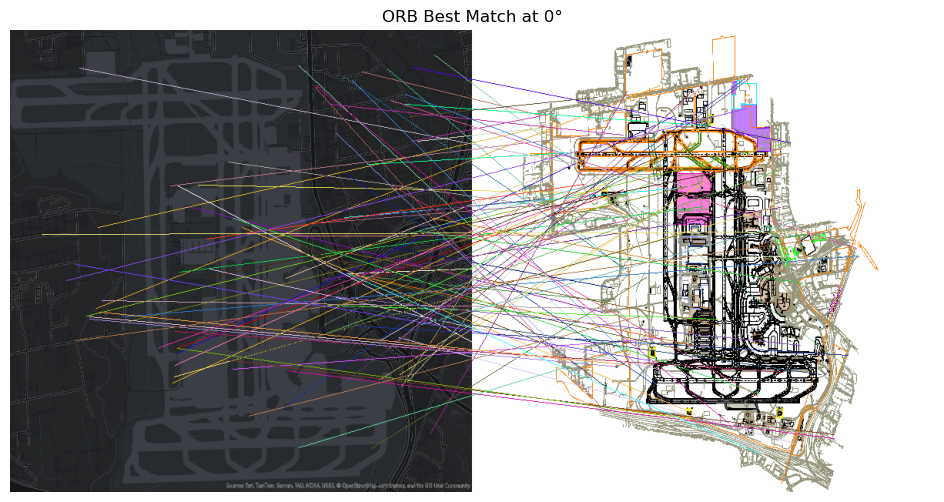

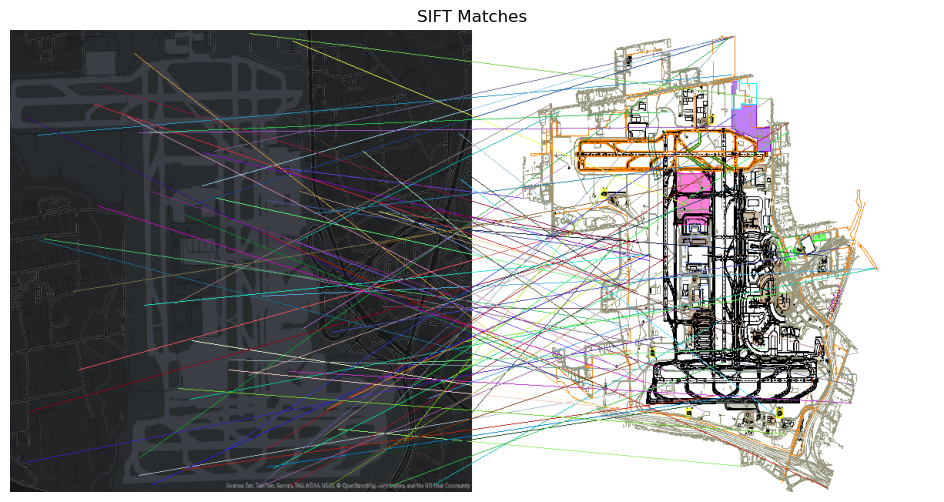

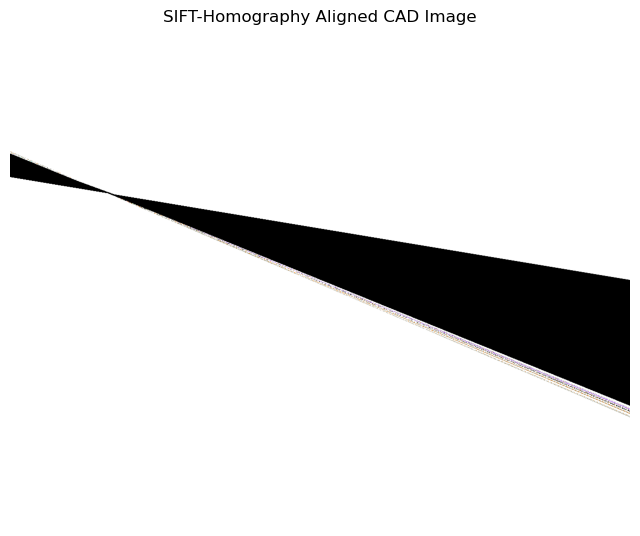

In [141]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


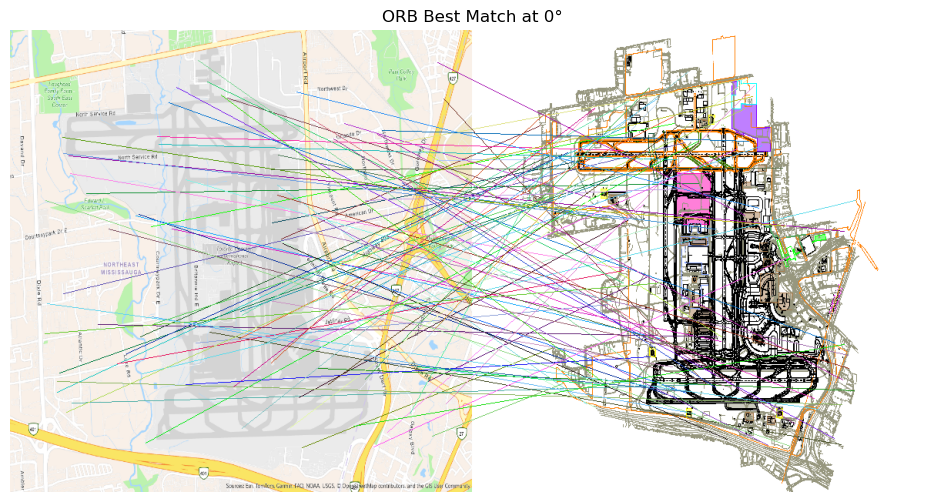

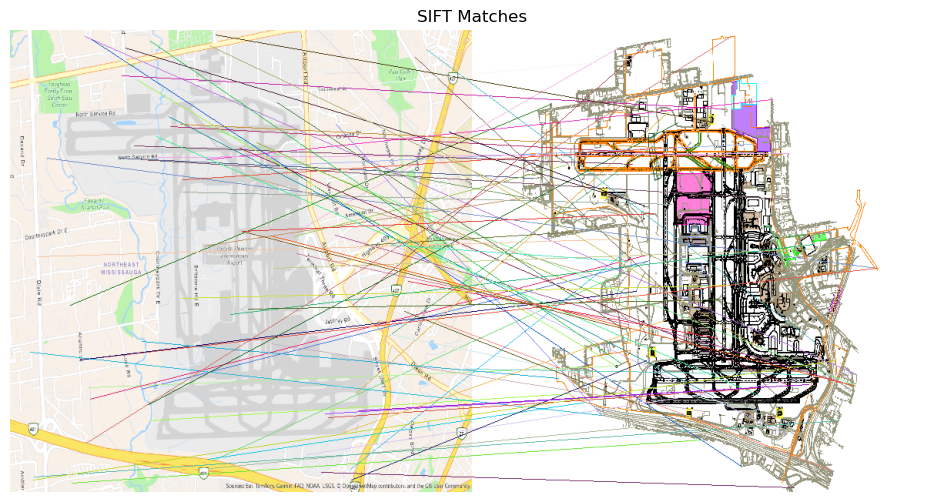

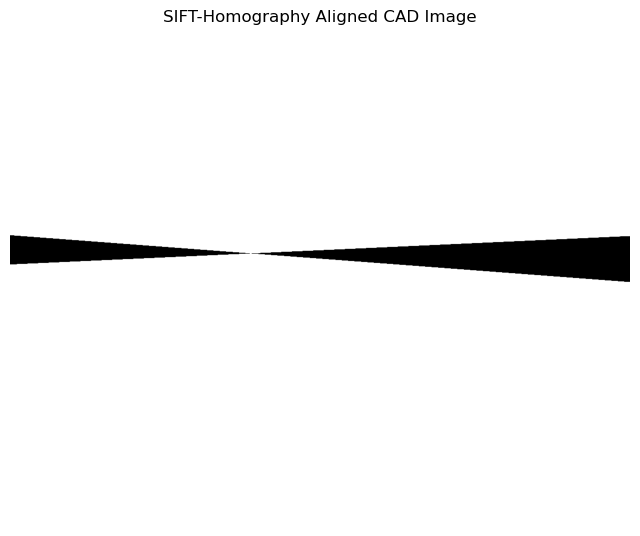

In [143]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


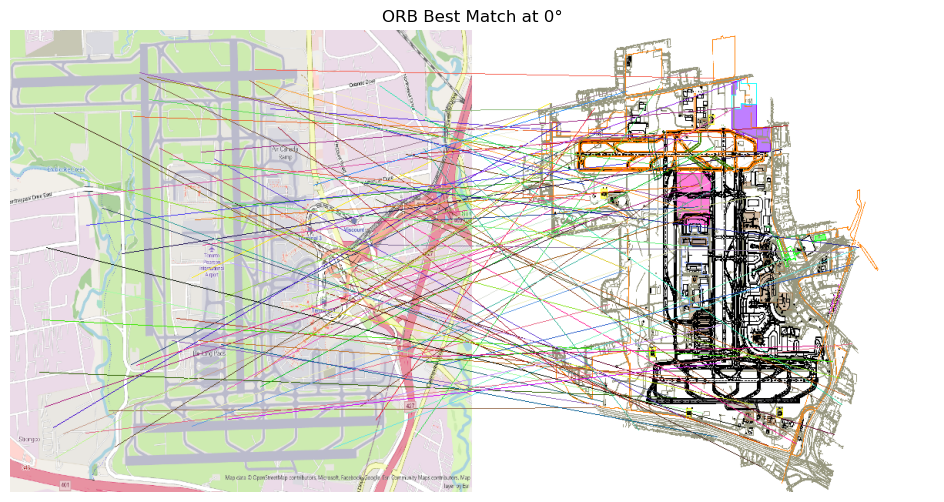

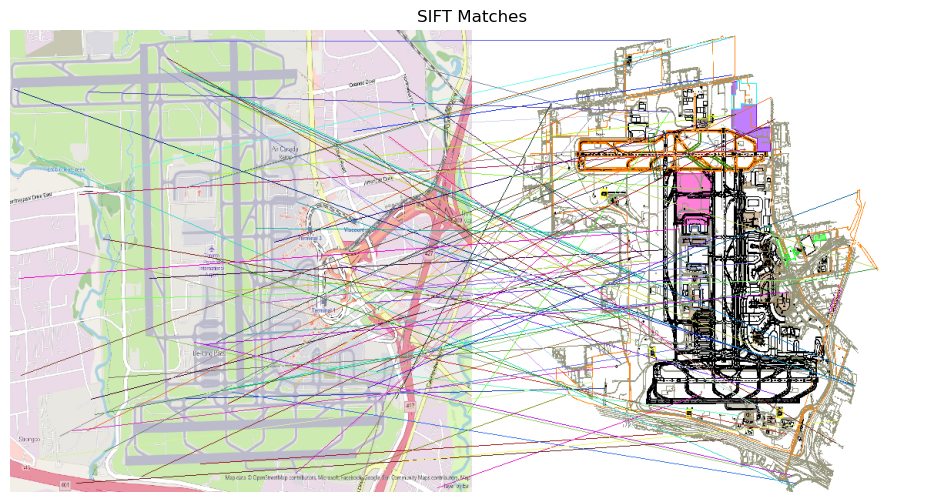

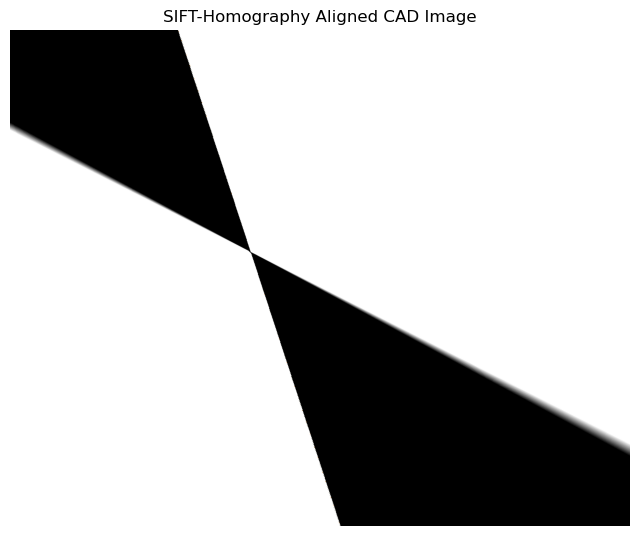

In [145]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/openstreet.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


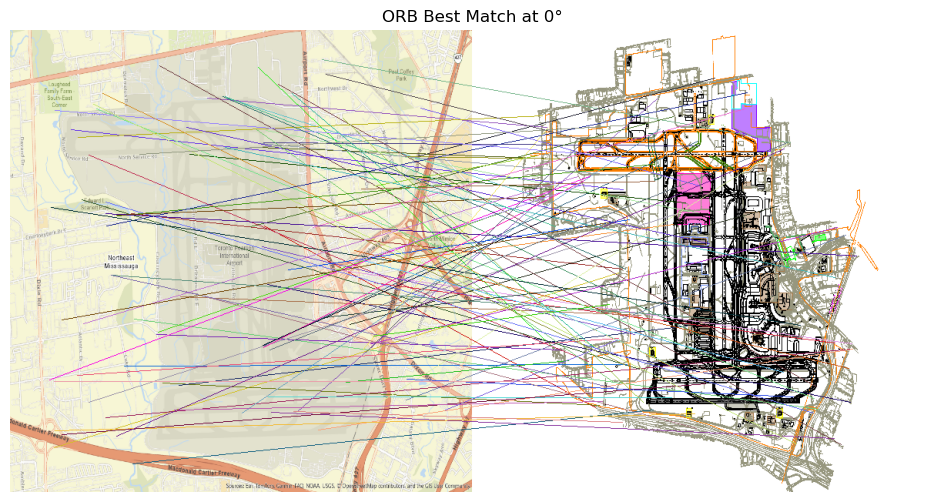

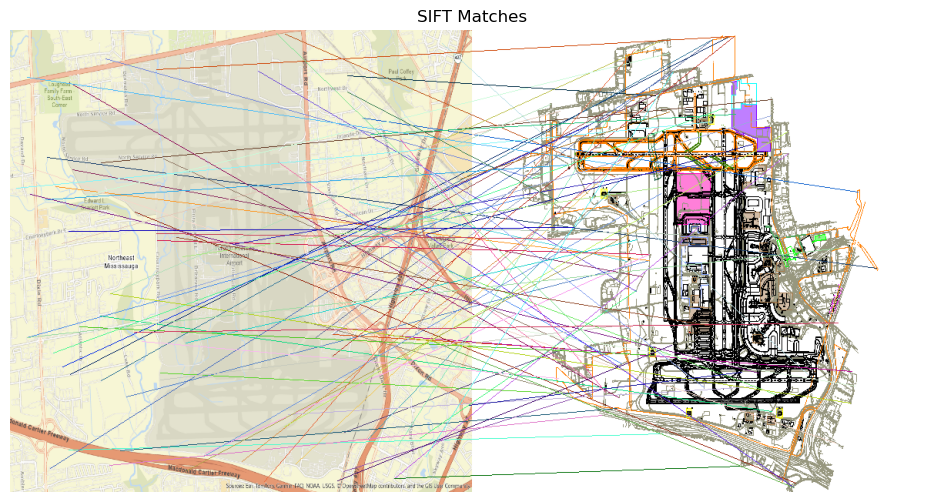

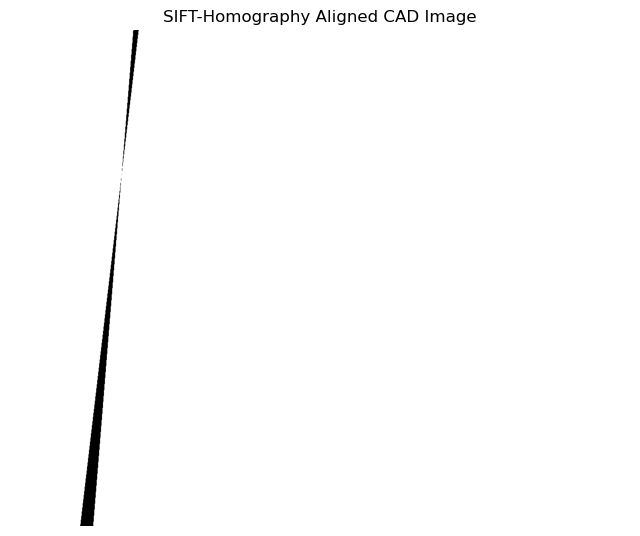

In [146]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/streets.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


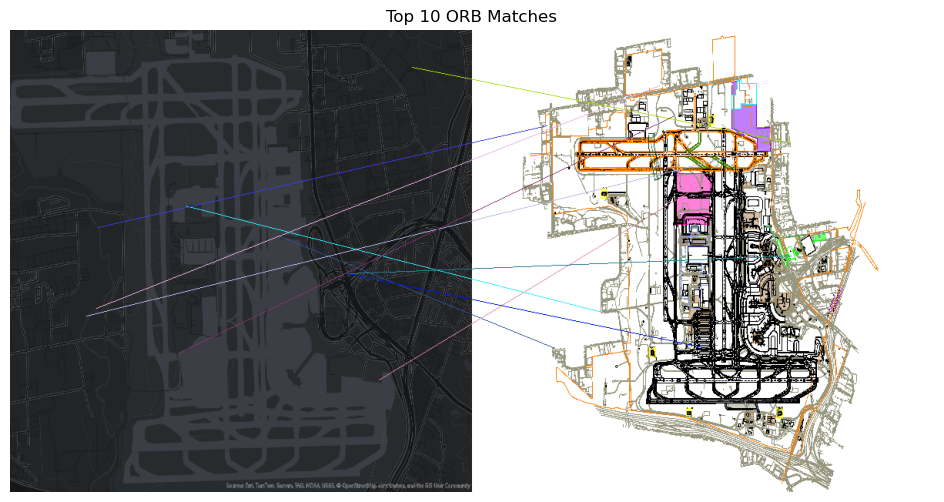

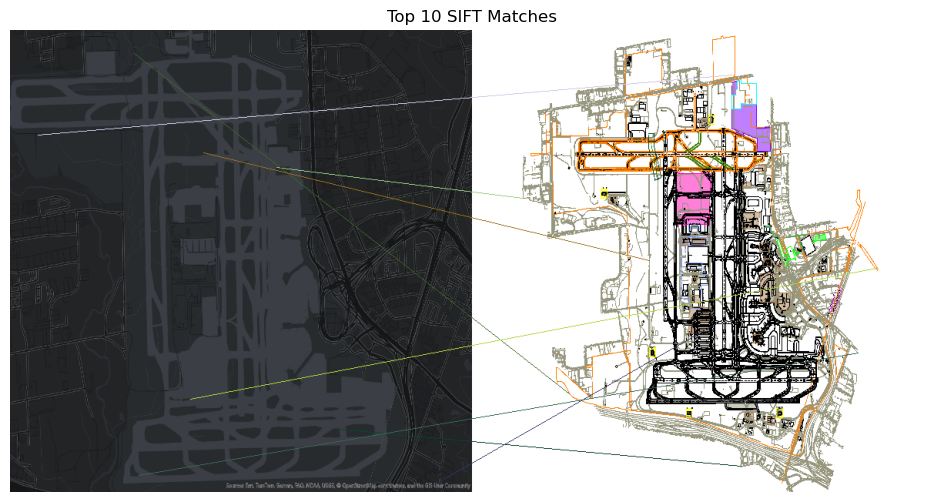

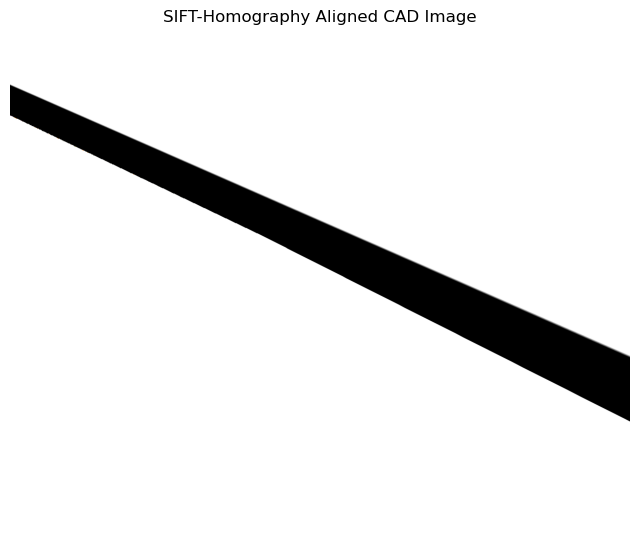

In [155]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(img1_processed, kp1_orb, img2_processed, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


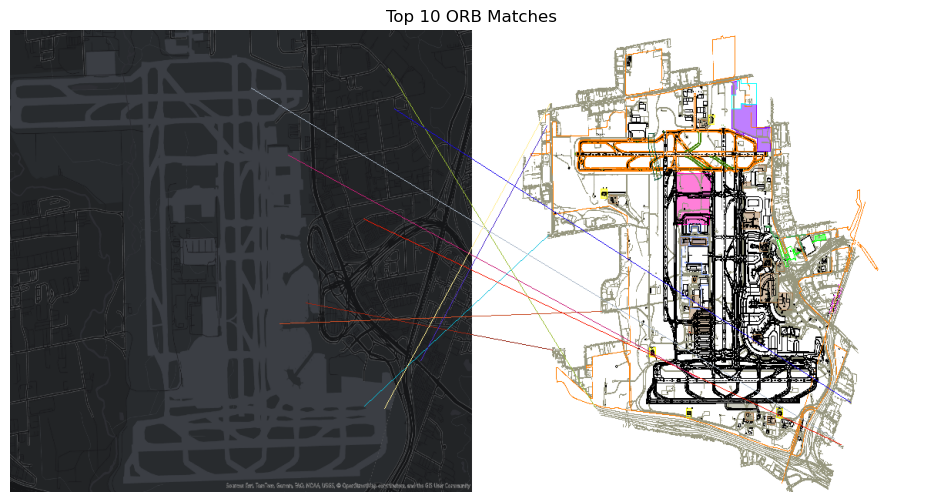

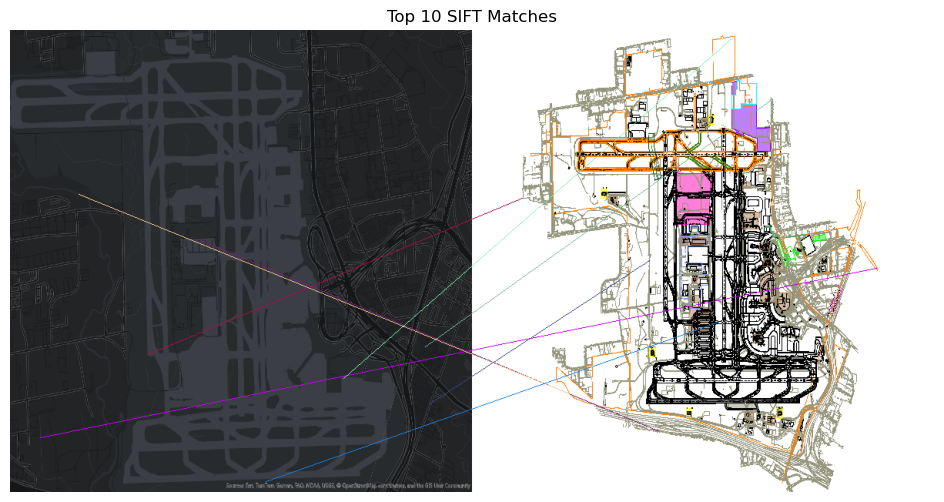

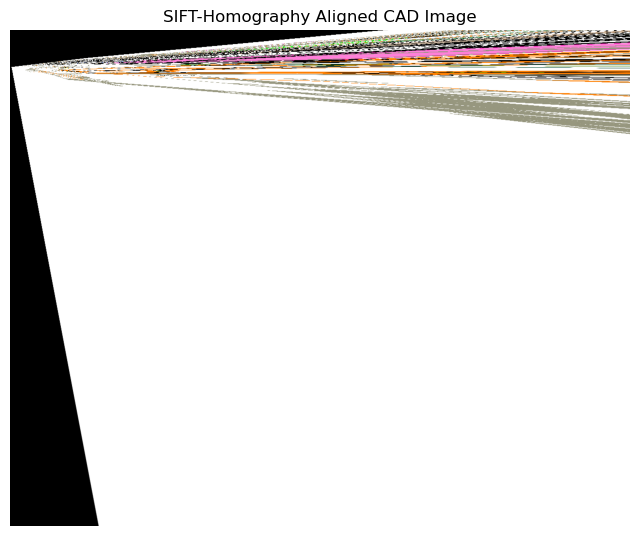

In [187]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600), invert=False):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    if invert:
        gray = cv2.bitwise_not(gray)  # Invert colors
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1, invert=True)  # Invert satellite image
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(img1_processed, kp1_orb, img2_processed, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


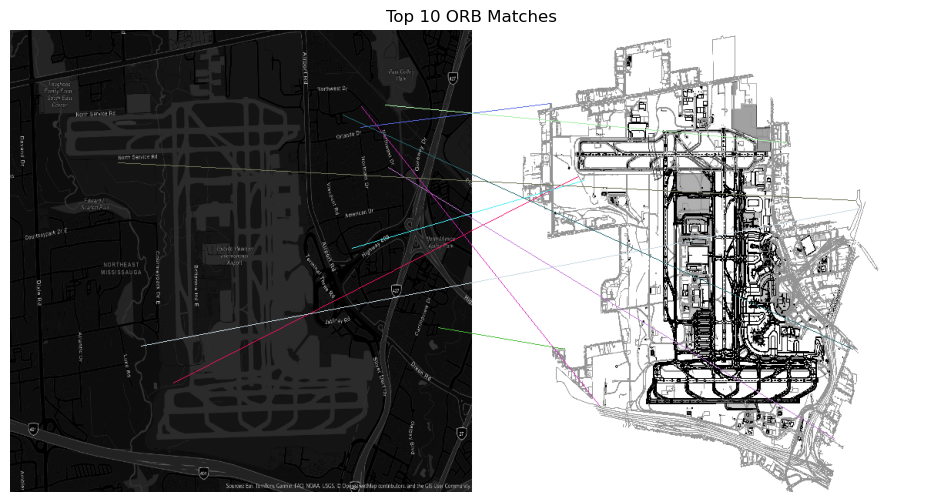

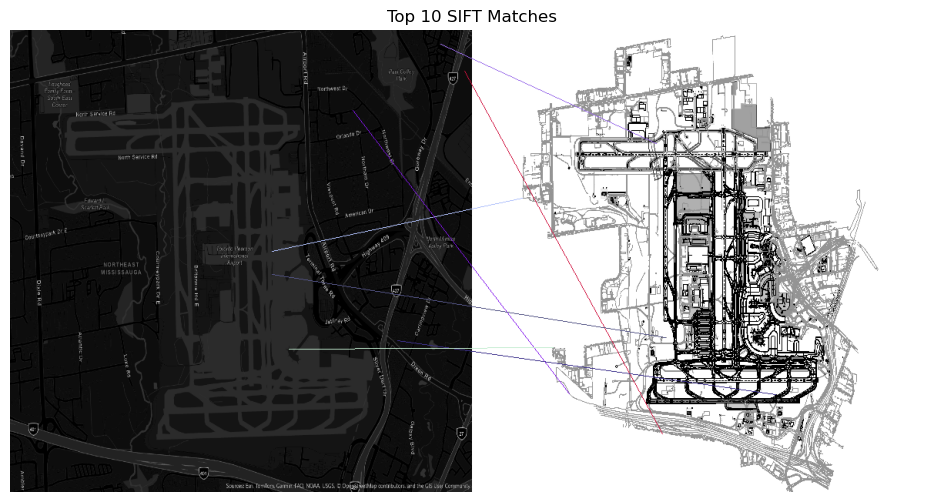

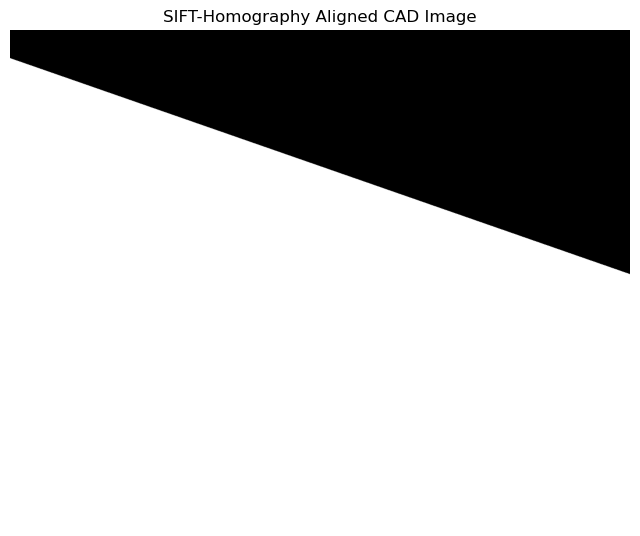

In [189]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600), invert=False):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    if invert:
        gray = cv2.bitwise_not(gray)  # Invert colors
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)  # Ensure dark areas become light and vice versa
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1, invert=True)  # Invert satellite image
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(gray1, kp1_orb, gray2, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(gray1, kp1_sift, gray2, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


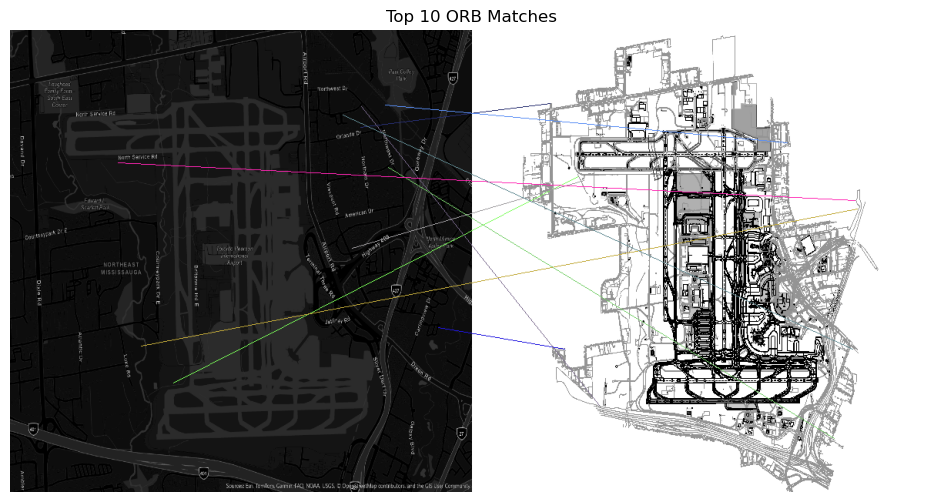

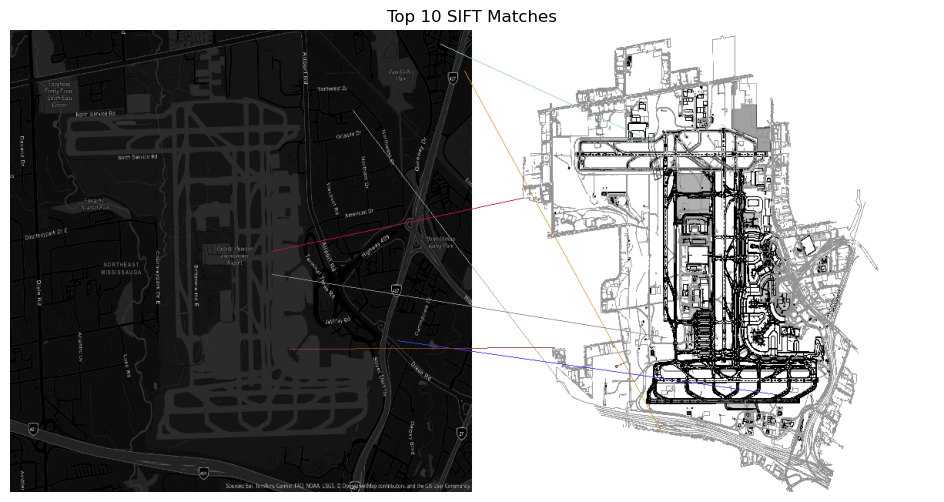

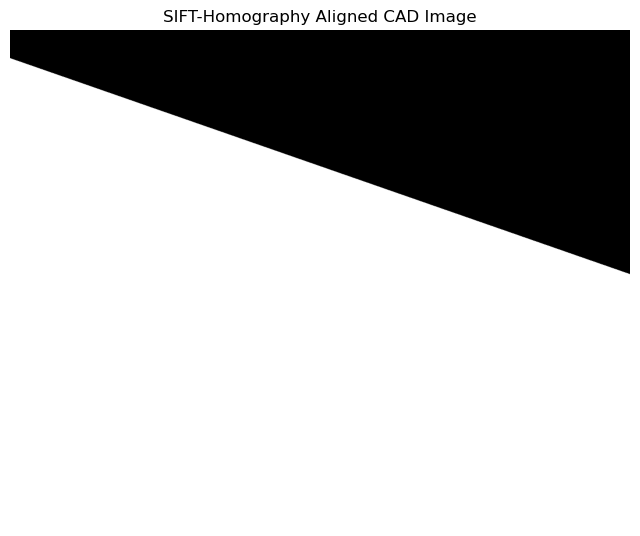

In [190]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600), invert=False):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    if invert:
        gray = cv2.bitwise_not(gray)  # Invert colors
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)  # Ensure dark areas become light and vice versa
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1, invert=True)  # Invert satellite image
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(gray1, kp1_orb, gray2, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(gray1, kp1_sift, gray2, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


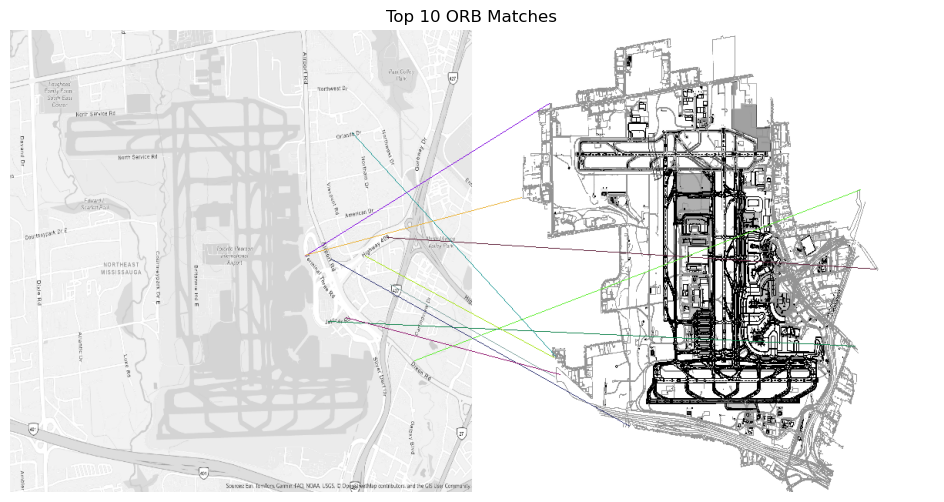

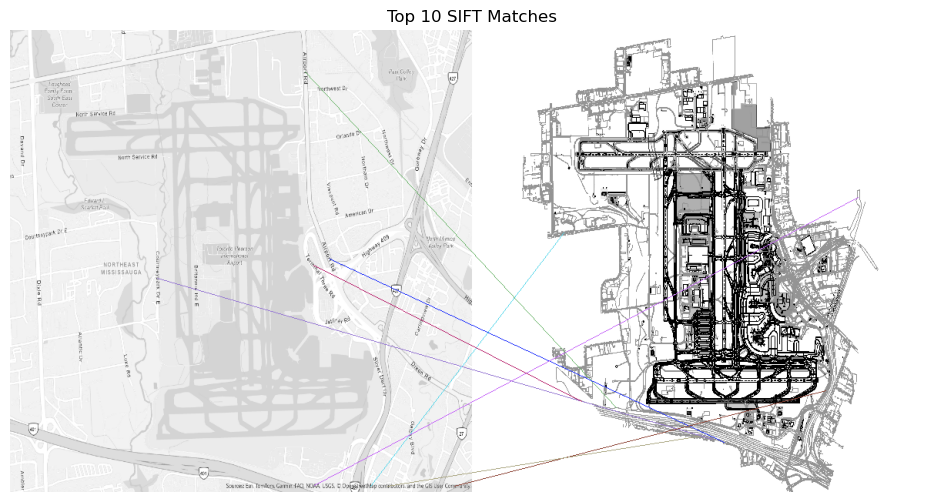

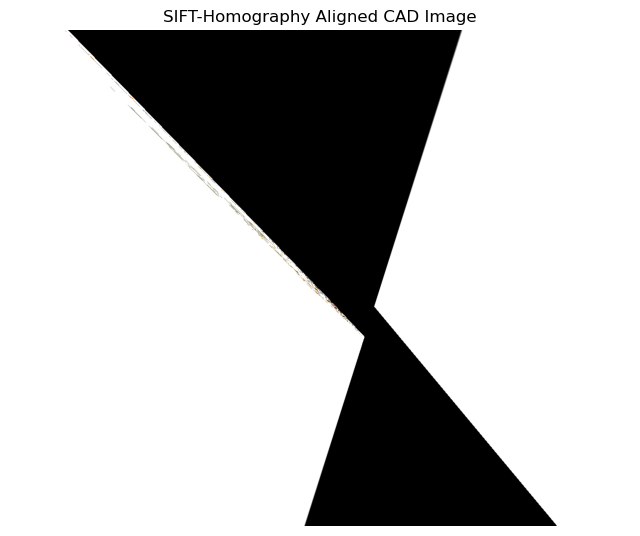

In [191]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)  # Blurs the image
    edges = cv2.Canny(blurred, threshold1=100, threshold2=200)  # Finds edges
    inverted = cv2.bitwise_not(edges)  # Invert colors to make dark parts light
    return img_resized, gray, inverted

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)  # Use new method
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(gray1, kp1_orb, gray2, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(gray1, kp1_sift, gray2, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


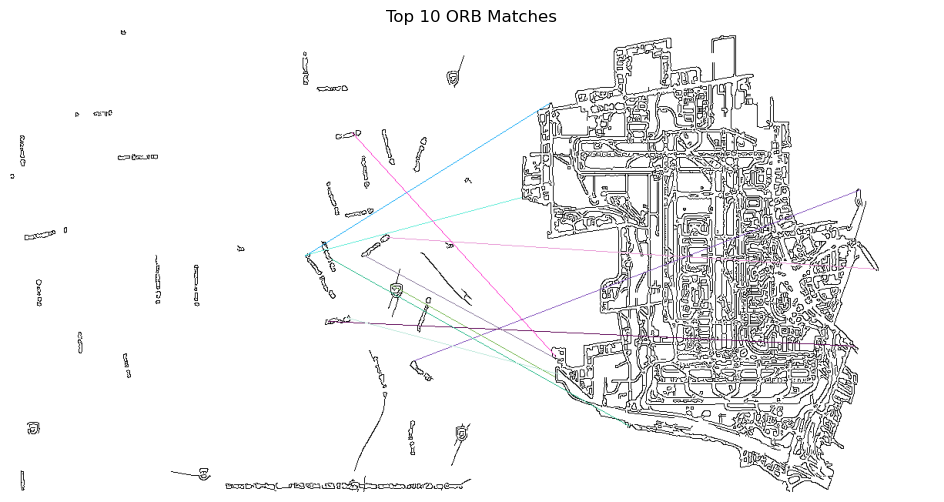

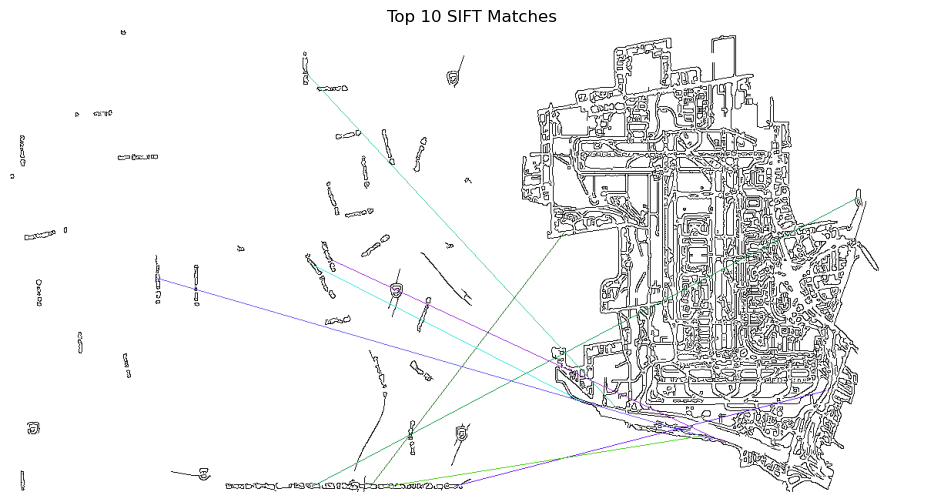

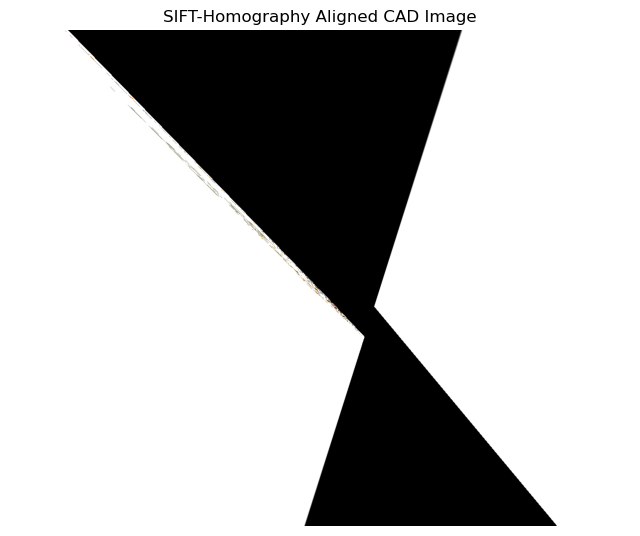

In [192]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)  # Blurs the image
    edges = cv2.Canny(blurred, threshold1=100, threshold2=200)  # Finds edges
    inverted = cv2.bitwise_not(edges)  # Invert colors to make dark parts light
    return img_resized, inverted, inverted  # Use inverted image for both matching and visualization

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

def compute_homography(kp1, kp2, matches):
    src_pts = np.array([kp1[m.queryIdx].pt for m in matches], dtype=np.float32)
    dst_pts = np.array([kp2[m.trainIdx].pt for m in matches], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)  # Use inverted image
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_edge_maps(edges1, edges2, method="ORB")
if matches_orb:
    visualize_matches(edges1, kp1_orb, edges2, kp2_orb, matches_orb, "Top 10 ORB Matches")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    visualize_matches(edges1, kp1_sift, edges2, kp2_sift, matches_sift, "Top 10 SIFT Matches")
    H = compute_homography(kp1_sift, kp2_sift, matches_sift)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


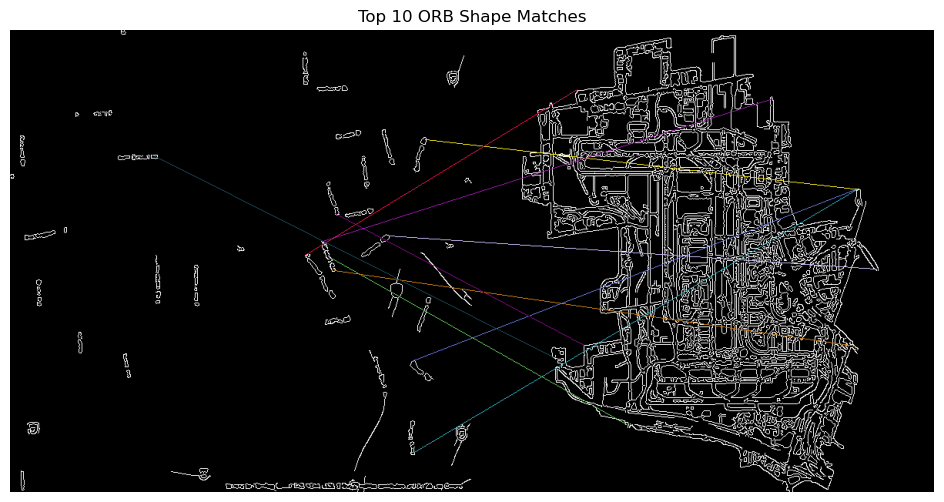

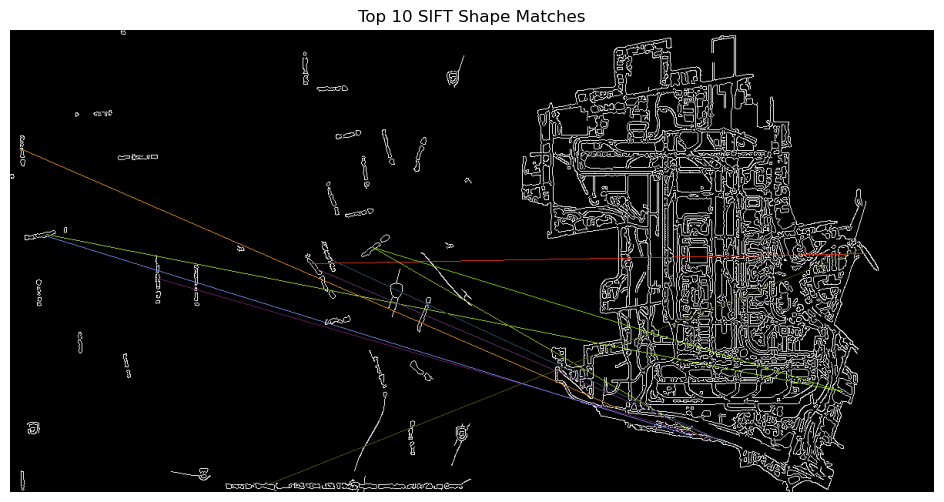

In [197]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)  # Blurs the image
    edges = cv2.Canny(blurred, threshold1=100, threshold2=200)  # Finds edges
    return img_resized, edges, edges  # Use edges for both matching and visualization

def extract_shapes(image):
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    shape_img = np.zeros_like(image)
    cv2.drawContours(shape_img, contours, -1, (255), 1)
    return shape_img

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_shapes(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, edges1, _ = preprocess_image(img1)
img2_processed, edges2, _ = preprocess_image(img2)

# Extract shapes from edge maps
shapes1 = extract_shapes(edges1)
shapes2 = extract_shapes(edges2)

# Rotate CAD image 35 degrees clockwise
shapes2 = rotate_image(shapes2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_shapes(shapes1, shapes2, method="ORB")
if matches_orb:
    visualize_matches(shapes1, kp1_orb, shapes2, kp2_orb, matches_orb, "Top 10 ORB Shape Matches")

matches_sift, kp1_sift, kp2_sift = match_shapes(shapes1, shapes2, method="SIFT")
if matches_sift:
    visualize_matches(shapes1, kp1_sift, shapes2, kp2_sift, matches_sift, "Top 10 SIFT Shape Matches")


In [196]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)  # Blurs the image
    edges = cv2.Canny(blurred, threshold1=100, threshold2=200)  # Finds edges
    return img_resized, edges, edges  # Use edges for both matching and visualization

def add_border(image, border_size=20):
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=255)

def extract_shapes(image):
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    shape_img = np.zeros_like(image)
    cv2.drawContours(shape_img, contours, -1, (255), 1)
    return shape_img

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_shapes(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1 = add_border(img1)  # Add a border to the satellite image
img1_processed, edges1, _ = preprocess_image(img1)
img2_processed, edges2, _ = preprocess_image(img2)

# Extract shapes from edge maps
shapes1 = extract_shapes(edges1)
shapes2 = extract_shapes(edges2)

# Rotate CAD image 35 degrees clockwise
shapes2 = rotate_image(shapes2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_shapes(shapes1, shapes2, method="ORB")
if matches_orb:
    visualize_matches(shapes1, kp1_orb, shapes2, kp2_orb, matches_orb, "Top 10 ORB Shape Matches")

matches_sift, kp1_sift, kp2_sift = match_shapes(shapes1, shapes2, method="SIFT")
if matches_sift:
    visualize_matches(shapes1, kp1_sift, shapes2, kp2_sift, matches_sift, "Top 10 SIFT Shape Matches")


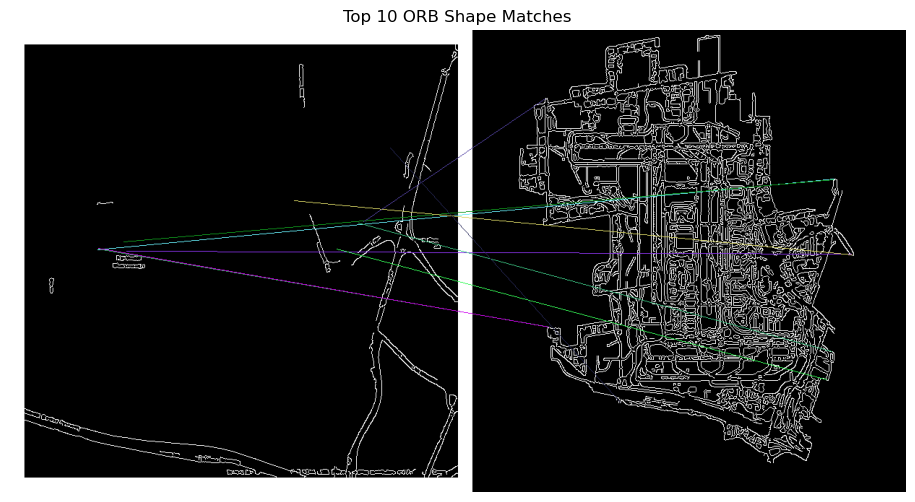

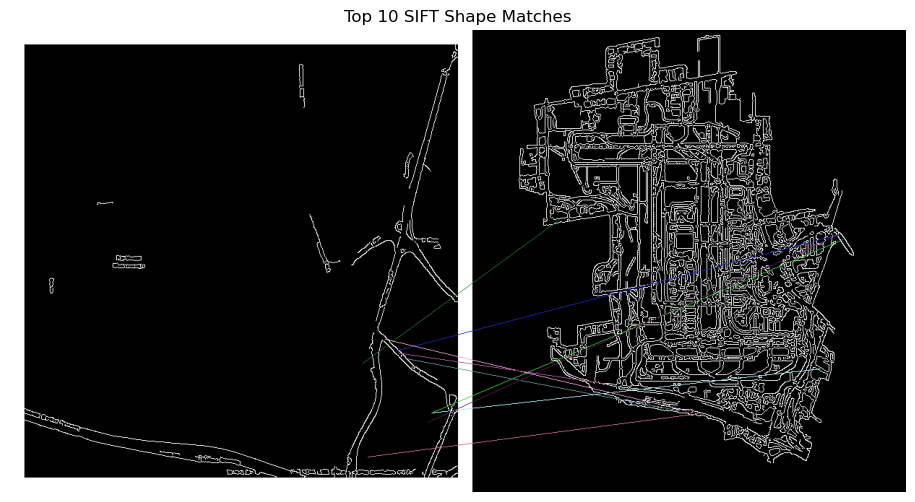

In [198]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)  # Blurs the image
    edges = cv2.Canny(blurred, threshold1=100, threshold2=200)  # Finds edges
    return img_resized, edges, edges  # Use edges for both matching and visualization

def add_border(image, border_size=20):
    bordered_image = cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=255)
    return bordered_image

def extract_shapes(image):
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    shape_img = np.zeros_like(image)
    cv2.drawContours(shape_img, contours, -1, (255), 1)
    return shape_img

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_shapes(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    img1_with_border = add_border(img1)  # Add a border for visualization
    h1, w1 = img1_with_border.shape[:2]
    h2, w2 = img2.shape[:2]
    img1_with_border = cv2.cvtColor(img1_with_border, cv2.COLOR_GRAY2BGR) if len(img1_with_border.shape) == 2 else img1_with_border
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1_with_border
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/streets.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, edges1, _ = preprocess_image(img1)
img2_processed, edges2, _ = preprocess_image(img2)

# Extract shapes from edge maps
shapes1 = extract_shapes(edges1)
shapes2 = extract_shapes(edges2)

# Rotate CAD image 35 degrees clockwise
shapes2 = rotate_image(shapes2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_shapes(shapes1, shapes2, method="ORB")
if matches_orb:
    visualize_matches(shapes1, kp1_orb, shapes2, kp2_orb, matches_orb, "Top 10 ORB Shape Matches")

matches_sift, kp1_sift, kp2_sift = match_shapes(shapes1, shapes2, method="SIFT")
if matches_sift:
    visualize_matches(shapes1, kp1_sift, shapes2, kp2_sift, matches_sift, "Top 10 SIFT Shape Matches")


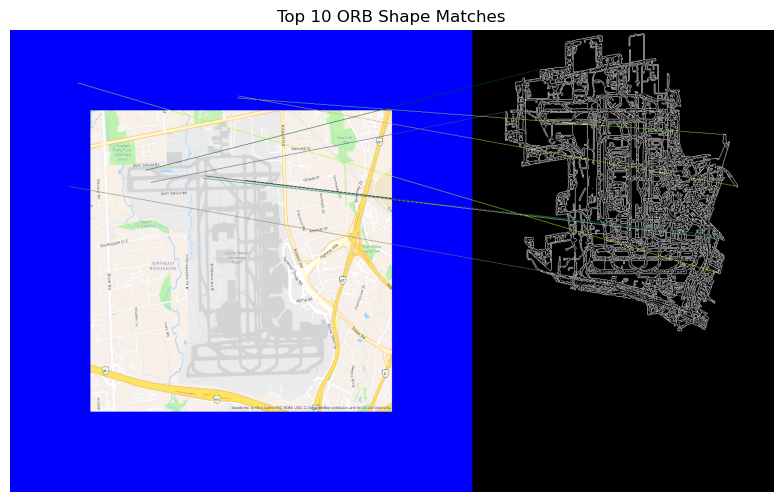

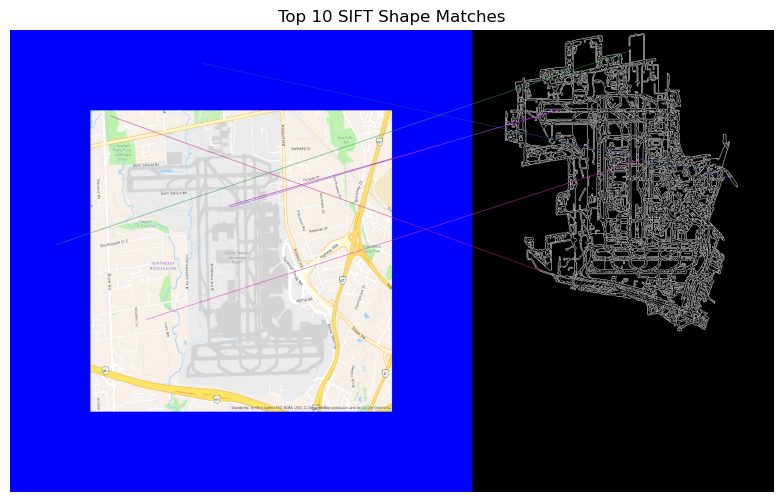

In [212]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    edges = cv2.Canny(img_resized, threshold1=100, threshold2=200)  # Finds edges
    return img_resized, edges, edges  # Use edges for both matching and visualization

def add_border(image, border_size=80):
    bordered_image = cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=255)
    return bordered_image

def extract_shapes(image):
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    shape_img = np.zeros_like(image)
    cv2.drawContours(shape_img, contours, -1, (255), 1)
    return shape_img

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_shapes(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:10]  # Keep only the 10 best matches
    
    return matches, kp1, kp2

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    img1_with_border = add_border(img1)  # Add a border for visualization
    h1, w1 = img1_with_border.shape[:2]
    h2, w2 = img2.shape[:2]
    img1_with_border = cv2.cvtColor(img1_with_border, cv2.COLOR_GRAY2BGR) if len(img1_with_border.shape) == 2 else img1_with_border
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1_with_border
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        if kp1_pt[0] < 60 or kp1_pt[0] > w1 - 60 or kp1_pt[1] < 60 or kp1_pt[1] > h1 - 60:
            continue  # Ignore matches behind the border
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, edges1, _ = preprocess_image(img1)
img2_processed, edges2, _ = preprocess_image(img2)

# Add border to original satellite image for visualization
img1_with_border = add_border(img1_processed)

# Extract shapes from edge maps
shapes1 = extract_shapes(edges1)
shapes2 = extract_shapes(edges2)

# Rotate CAD image 35 degrees clockwise
shapes2 = rotate_image(shapes2, 0)
img2_processed = rotate_image(img2_processed, 0)

matches_orb, kp1_orb, kp2_orb = match_shapes(shapes1, shapes2, method="ORB")
if matches_orb:
    visualize_matches(img1_with_border, kp1_orb, shapes2, kp2_orb, matches_orb, "Top 10 ORB Shape Matches")

matches_sift, kp1_sift, kp2_sift = match_shapes(shapes1, shapes2, method="SIFT")
if matches_sift:
    visualize_matches(img1_with_border, kp1_sift, shapes2, kp2_sift, matches_sift, "Top 10 SIFT Shape Matches")


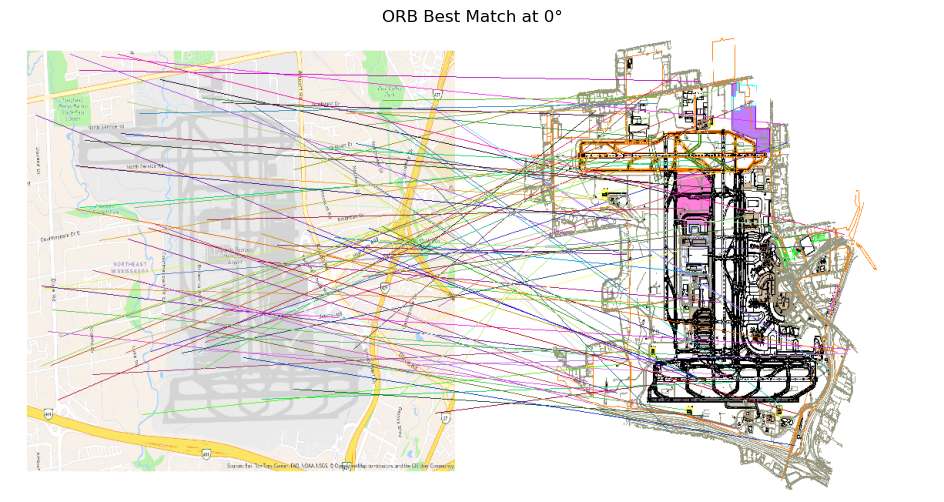

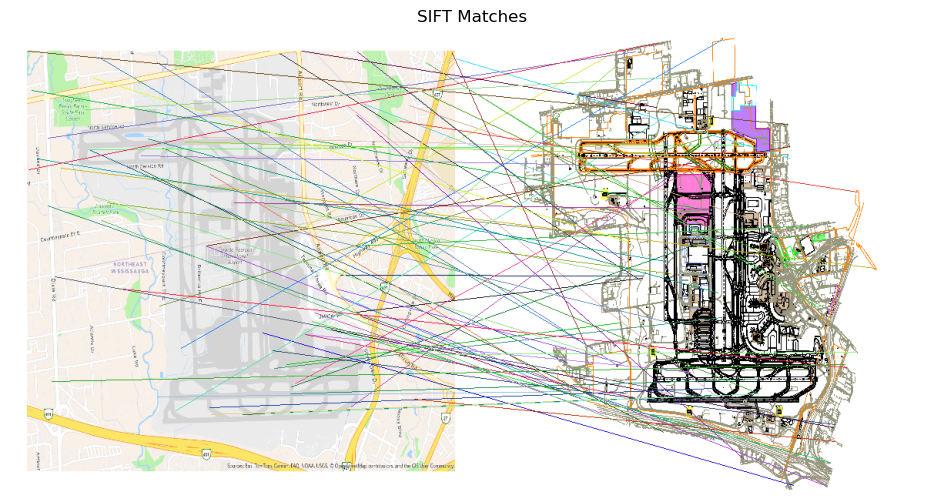

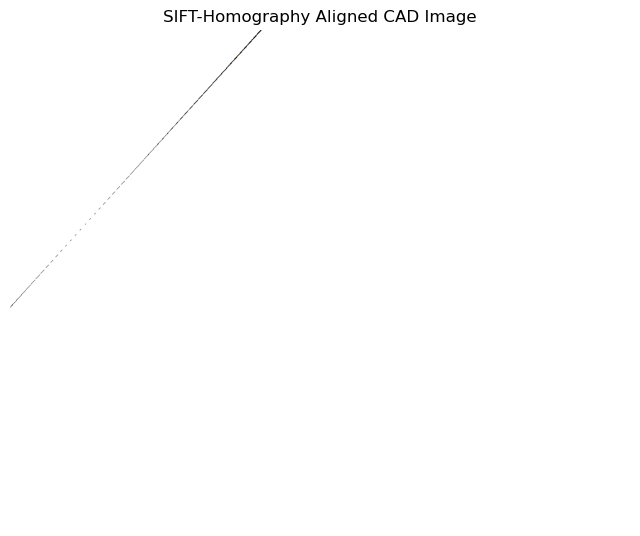

In [216]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def add_border(image, border_size=50):
    """Add a border around the image to exclude areas from matching."""
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(255, 255, 255))

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, threshold=10):
    """Remove matches where lines overlap too frequently."""
    filtered_matches = []
    drawn_segments = []
    
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        overlaps = sum(1 for seg in drawn_segments if np.linalg.norm(np.array(p1) - np.array(seg[0])) < threshold and
                                                          np.linalg.norm(np.array(p2) - np.array(seg[1])) < threshold)
        if overlaps < 3:
            filtered_matches.append(match)
            drawn_segments.append((p1, p2))
    
    return filtered_matches

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches


def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

# Add border around satellite image
border_size = 50
img1_with_border = add_border(img1)
img2_with_border = add_border(img2)

img1_processed, gray1, edges1 = preprocess_image(img1_with_border)
img2_processed, gray2, edges2 = preprocess_image(img2_with_border)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

# Filter matches to ensure they are in the same quadrant
best_matches = filter_quadrant_matches(best_matches, best_kp1, best_kp2, img1.shape, img2.shape)
best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)

visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


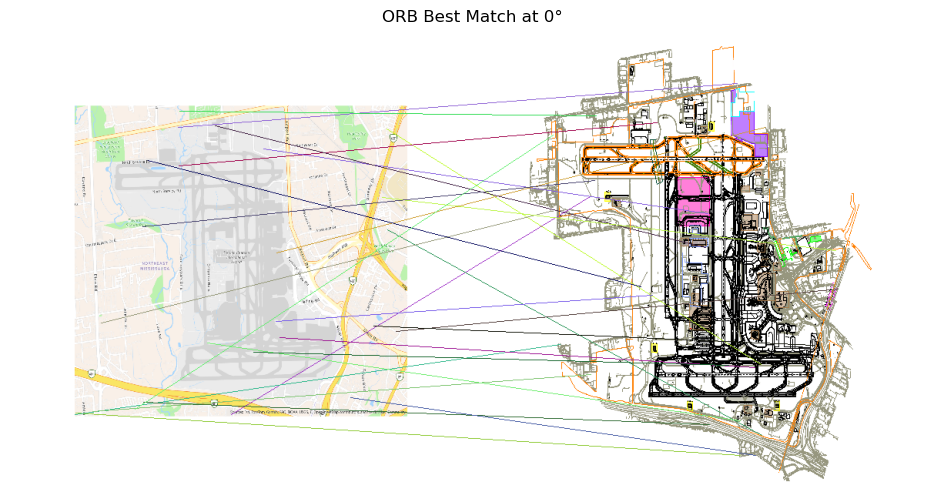

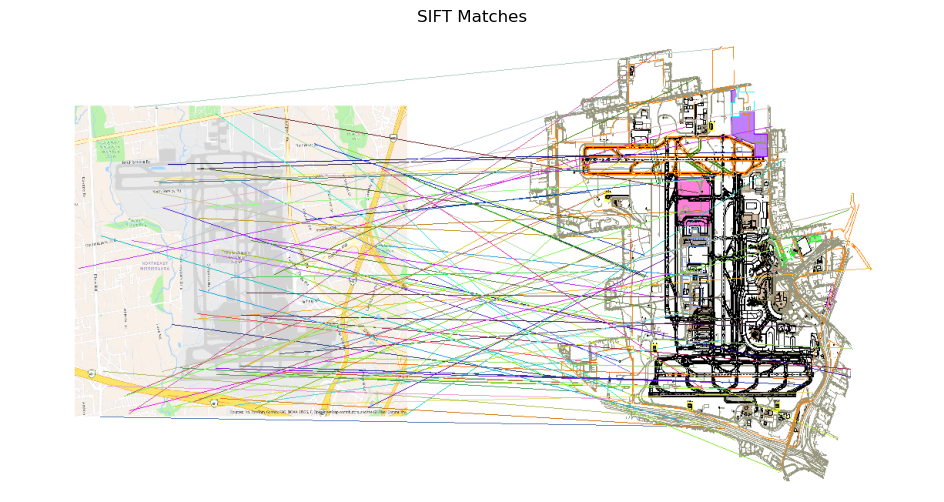

In [223]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def add_border(image, border_size=100):
    """Add a larger border around the image to exclude areas from matching."""
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(255, 255, 255))

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_non_intersecting_matches(matches, kp1, kp2, threshold=10):
    """Eliminate matches where the lines between points intersect too much."""
    filtered_matches = []
    drawn_segments = []
    
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        intersects = False
        for seg in drawn_segments:
            # Check if the current line intersects with any of the previous lines
            if lines_intersect(p1, p2, seg[0], seg[1], threshold):
                intersects = True
                break
        
        if not intersects:
            filtered_matches.append(match)
            drawn_segments.append((p1, p2))
    
    return filtered_matches

def lines_intersect(p1, p2, p3, p4, threshold=10):
    """Check if two line segments intersect."""
    def ccw(A, B, C):
        return (C[1] - A[1]) * (B[0] - A[0]) > (B[1] - A[1]) * (C[0] - A[0])
    
    return ccw(p1, p3, p4) != ccw(p2, p3, p4) and ccw(p1, p2, p3) != ccw(p1, p2, p4)

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

# Add a larger border around the satellite image
border_size = 250
img1_with_border = add_border(img1, border_size)
img2_with_border = add_border(img2, border_size)

img1_processed, gray1, edges1 = preprocess_image(img1_with_border)
img2_processed, gray2, edges2 = preprocess_image(img2_with_border)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

# Filter matches to ensure they are in the same quadrant
best_matches = filter_quadrant_matches(best_matches, best_kp1, best_kp2, img1.shape, img2.shape)
best_matches = filter_non_intersecting_matches(best_matches, best_kp1, best_kp2, threshold=15)
best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)

visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    #matches_sift = filter_non_intersecting_matches(matches_sift, kp1_sift, kp2_sift, threshold=15)
    #matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")


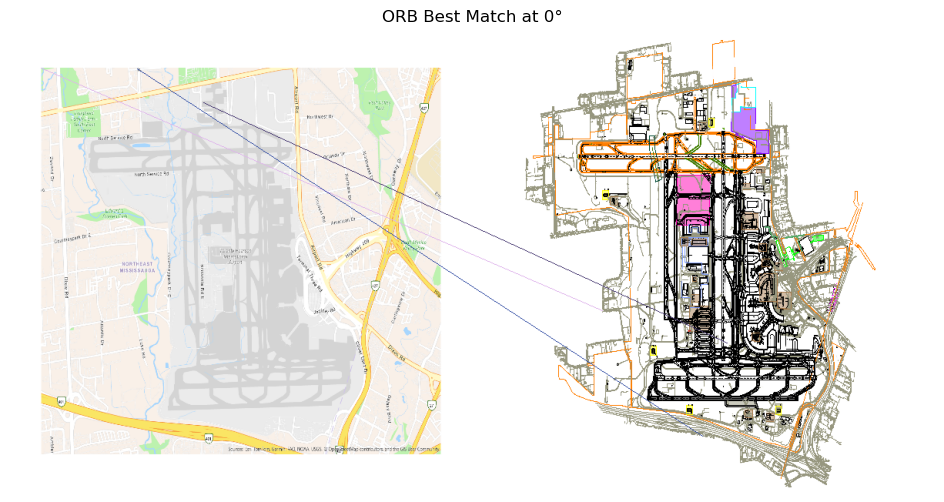

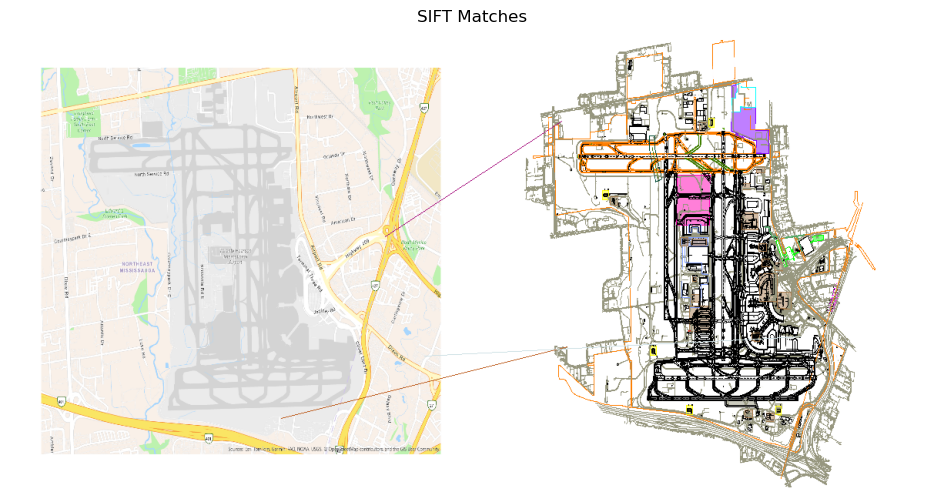

In [224]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
import math

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def add_border(image, border_size=100):
    """Add a larger border around the image to exclude areas from matching."""
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(255, 255, 255))

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_parallel_matches(matches, kp1, kp2, threshold_angle=10, threshold_distance=30):
    """Filter matches to keep parallel lines or at least non-intersecting lines."""
    filtered_matches = []
    drawn_segments = []
    
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        # Calculate the slope of the line formed by the match (p1, p2)
        angle1 = calculate_angle(p1, p2)
        
        intersects = False
        for seg in drawn_segments:
            p3, p4 = seg
            angle2 = calculate_angle(p3, p4)
            
            # Check if the angle difference is above the threshold, discard if it's too high
            angle_diff = abs(angle1 - angle2)
            if angle_diff > threshold_angle:
                intersects = True
                break
        
        if not intersects:
            filtered_matches.append(match)
            drawn_segments.append((p1, p2))
    
    return filtered_matches

def calculate_angle(p1, p2):
    """Calculate the angle of the line between two points relative to the x-axis."""
    dx = p2[0] - p1[0]
    dy = p2[1] - p1[1]
    angle = math.atan2(dy, dx) * 180.0 / math.pi  # Angle in degrees
    return angle

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

# Add a larger border around the satellite image
border_size = 100
img1_with_border = add_border(img1, border_size)
img2_with_border = add_border(img2, border_size)

img1_processed, gray1, edges1 = preprocess_image(img1_with_border)
img2_processed, gray2, edges2 = preprocess_image(img2_with_border)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

# Filter matches to ensure they are in the same quadrant
best_matches = filter_quadrant_matches(best_matches, best_kp1, best_kp2, img1.shape, img2.shape)

# Filter parallel and non-intersecting matches
best_matches = filter_parallel_matches(best_matches, best_kp1, best_kp2, threshold_angle=10, threshold_distance=30)

visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    matches_sift = filter_parallel_matches(matches_sift, kp1_sift, kp2_sift, threshold_angle=10, threshold_distance=30)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")


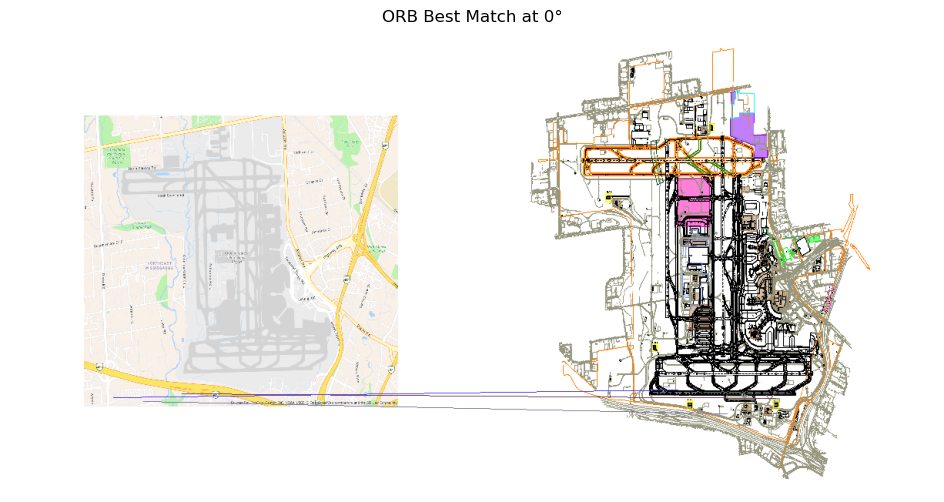

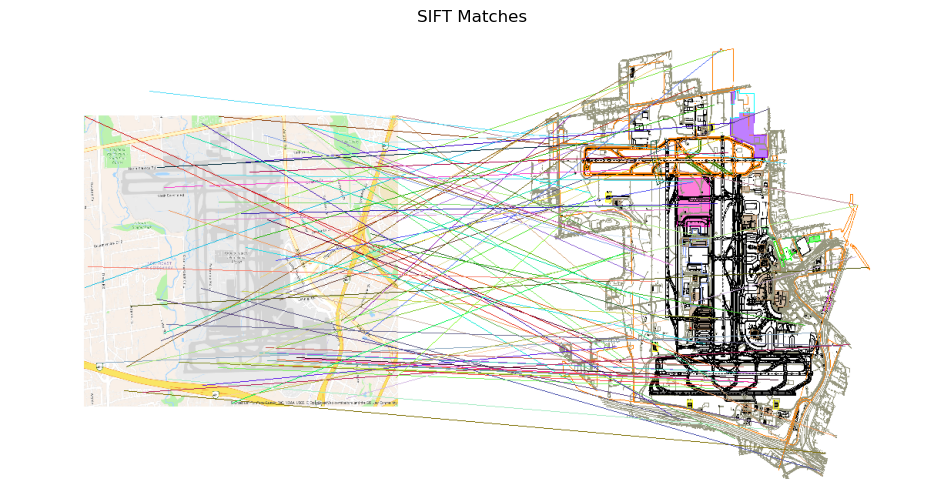

In [228]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
import math

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def add_border(image, border_size=100):
    """Add a larger border around the image to exclude areas from matching."""
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(255, 255, 255))

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def calculate_angle(p1, p2):
    """Calculate the angle of the line between two points relative to the x-axis (in degrees)."""
    dx = p2[0] - p1[0]
    dy = p2[1] - p1[1]
    angle = math.atan2(dy, dx) * 180.0 / math.pi  # Angle in degrees
    return angle

def filter_nearly_horizontal_matches(matches, kp1, kp2, threshold_angle=10):
    """Filter matches to keep only nearly horizontal lines."""
    filtered_matches = []
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        # Calculate the angle of the line formed by the match (p1, p2)
        angle = calculate_angle(p1, p2)
        
        # Keep match only if the angle is close to 0 (nearly horizontal)
        if abs(angle) <= threshold_angle:
            filtered_matches.append(match)
    
    return filtered_matches

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

# Add a larger border around the satellite image
border_size = 300
img1_with_border = add_border(img1, border_size)
img2_with_border = add_border(img2, border_size)

img1_processed, gray1, edges1 = preprocess_image(img1_with_border)
img2_processed, gray2, edges2 = preprocess_image(img2_with_border)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

# Filter matches to ensure they are in the same quadrant
best_matches = filter_quadrant_matches(best_matches, best_kp1, best_kp2, img1.shape, img2.shape)

# Filter for nearly horizontal matches
best_matches = filter_nearly_horizontal_matches(best_matches, best_kp1, best_kp2, threshold_angle=10)

visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    #matches_sift = filter_nearly_horizontal_matches(matches_sift, kp1_sift, kp2_sift, threshold_angle=10)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")


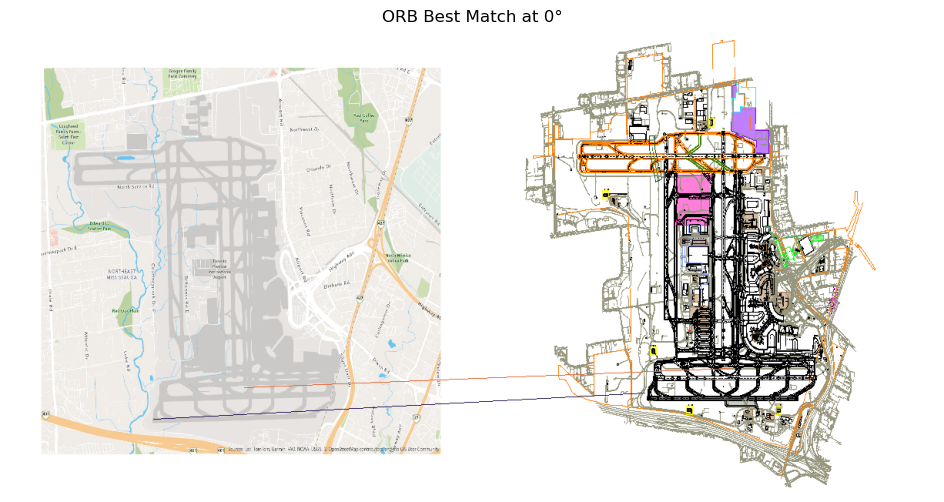

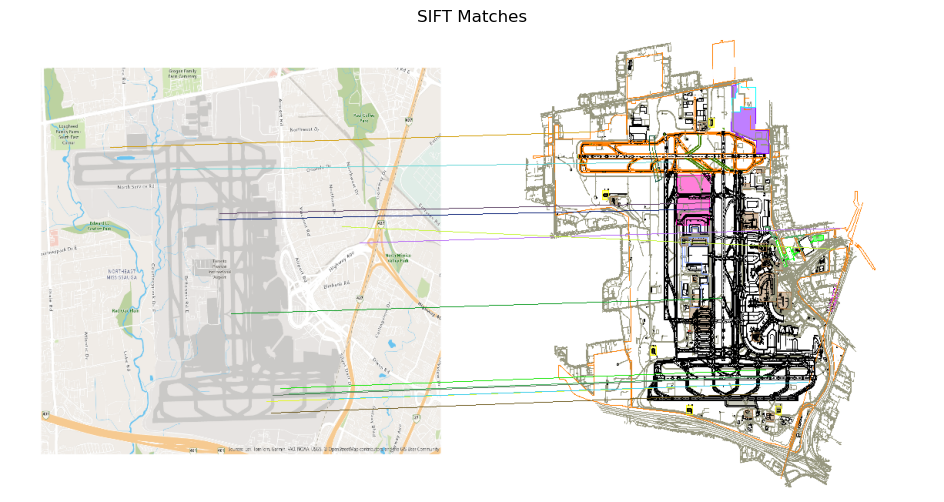

In [232]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
import math

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def add_border(image, border_size=100):
    """Add a larger border around the image to exclude areas from matching."""
    return cv2.copyMakeBorder(image, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(255, 255, 255))

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def calculate_angle(p1, p2):
    """Calculate the angle of the line between two points relative to the x-axis (in degrees)."""
    dx = p2[0] - p1[0]
    dy = p2[1] - p1[1]
    angle = math.atan2(dy, dx) * 180.0 / math.pi  # Angle in degrees
    return angle

def calculate_distance(p1, p2):
    """Calculate the Euclidean distance between two points."""
    return np.linalg.norm(np.array(p2) - np.array(p1))

def filter_extreme_slope_and_long_matches(matches, kp1, kp2, max_angle=45, max_distance_ratio=0.1):
    """Filter matches to remove those with extreme slopes or excessive distances."""
    filtered_matches = []
    max_distance = 0  # To track the longest distance
    
    # First pass: calculate the maximum distance
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        distance = calculate_distance(p1, p2)
        max_distance = max(max_distance, distance)
    
    # Second pass: filter based on slope and distance
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        # Calculate the angle of the line formed by the match (p1, p2)
        angle = calculate_angle(p1, p2)
        
        # Calculate the Euclidean distance between the points
        distance = calculate_distance(p1, p2)
        
        # Keep match only if:
        # 1. The angle is less than the max_angle threshold (not too steep)
        # 2. The distance is within a certain ratio of the max distance (not too long)
        if abs(angle) <= max_angle and distance <= max_distance * max_distance_ratio:
            filtered_matches.append(match)
    
    return filtered_matches

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

# Add a larger border around the satellite image
border_size = 100
img1_with_border = add_border(img1, border_size)
img2_with_border = add_border(img2, border_size)

img1_processed, gray1, edges1 = preprocess_image(img1_with_border)
img2_processed, gray2, edges2 = preprocess_image(img2_with_border)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

# Filter matches to ensure they are in the same quadrant
best_matches = filter_quadrant_matches(best_matches, best_kp1, best_kp2, img1.shape, img2.shape)

# Filter for extreme slopes and long distances
best_matches = filter_extreme_slope_and_long_matches(best_matches, best_kp1, best_kp2, max_angle=45, max_distance_ratio=0.1)

visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    matches_sift = filter_extreme_slope_and_long_matches(matches_sift, kp1_sift, kp2_sift, max_angle=45, max_distance_ratio=0.1)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
